<a href="https://colab.research.google.com/github/PranayLendave/car-plus-virtual-background/blob/main/car_plus_virtual_background.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# U2Net Car Segmentation with Virtual Background

## Introduction
In this notebook, we will use U2Net for car segmentation and then, at the end, add a virtual background to the segmented car.

The workflow of the notebook is as follows:

1. **Setup**
   - Import necessary libraries and set up the environment.

2. **Custom Dataset Creation**
   - Prepare a custom dataset for training U2Net.

3. **Training U2Net on Custom Dataset**
   - Train the U2Net model using the custom dataset.

4. **Segmentation Using Trained Model**
   - Perform car segmentation using the trained U2Net model.

5. **Adding Virtual Background to the Segmented Car**
   - Apply a virtual background to the segmented car to create the final result.

Let's get started!


In [ ]:
!git clone https://github.com/PranayLendave/car-plus-virtual-background.git

Cloning into 'U-2-Net'...
remote: Enumerating objects: 1106, done.
remote: Counting objects: 100% (1106/1106), done.
remote: Compressing objects: 100% (570/570), done.
remote: Total 1106 (delta 556), reused 1062 (delta 531), pack-reused 0
Receiving objects: 100% (1106/1106), 66.95 MiB | 33.28 MiB/s, done.
Resolving deltas: 100% (556/556), done.


In [ ]:
!pip install wandb
!wandb login #enter api_key = e6abacbefff08b579b639780673999d0b4b0bdb9

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.5/189.5 kB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 218.8/218.8 kB 11.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.6 MB/s eta 0:00:00
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8791 sha256=43f4463b312cc5618661b181f0124b84f533889d1bd71cdce8d004693431ea3a
  Stored in directory: /root/.cache/pip/wheels/e7/f3/22/152153d6eb222ee7a56ff8617d80ee5207207a8c00a7aab794
Successfully built pathtools
wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
#unet weights

%cd /content/U-2-Net/saved_models
!mkdir u2net
%cd u2net
!gdown https://drive.google.com/file/d/1ao1ovG1Qtx4b7EoskHXmi2E9rp5CHLcZ/view --fuzzy
%cd /content/U-2-Net

/content/U-2-Net/saved_models
/content/U-2-Net/saved_models/u2net
Downloading...
From: https://drive.google.com/uc?id=1ao1ovG1Qtx4b7EoskHXmi2E9rp5CHLcZ
To: /content/U-2-Net/saved_models/u2net/u2net.pth
100% 176M/176M [00:02<00:00, 66.2MB/s]
/content/U-2-Net


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !rm -r /content/U-2-Net/datasets

In [ ]:
import shutil

source_folder_path = "/content/drive/MyDrive/colab_data/Computer Vision Engineer Task/dataset"
destination_folder_path = "/content/U-2-Net/dataset"

shutil.copytree(source_folder_path, destination_folder_path)



'/content/U-2-Net/dataset'

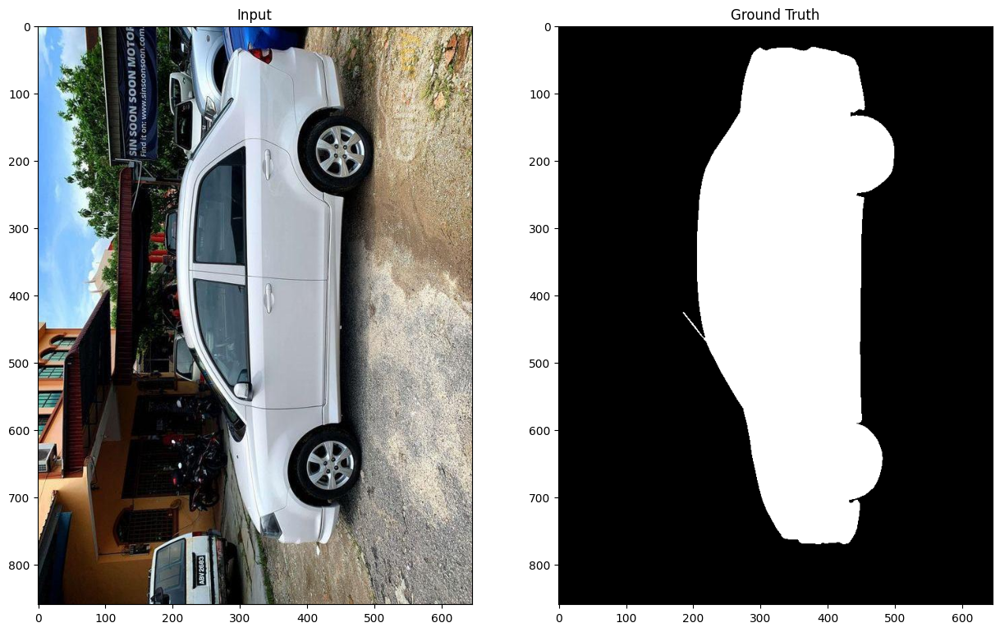

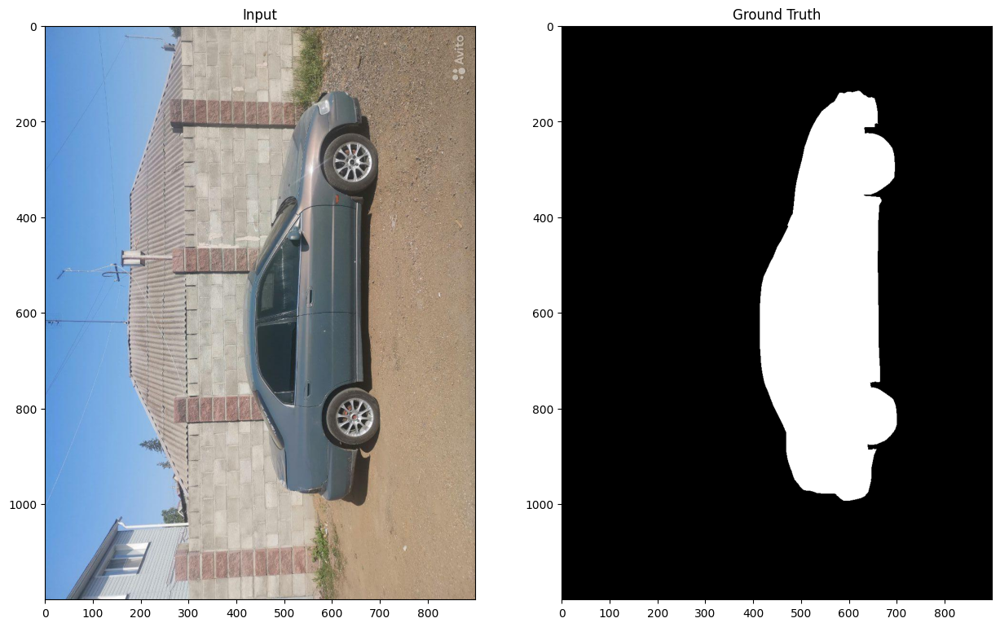

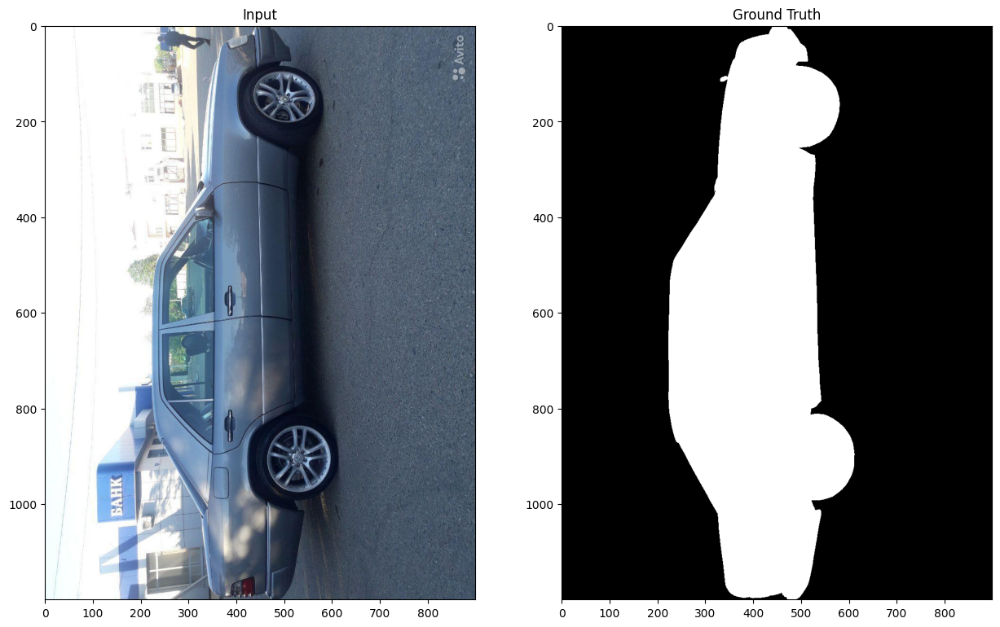

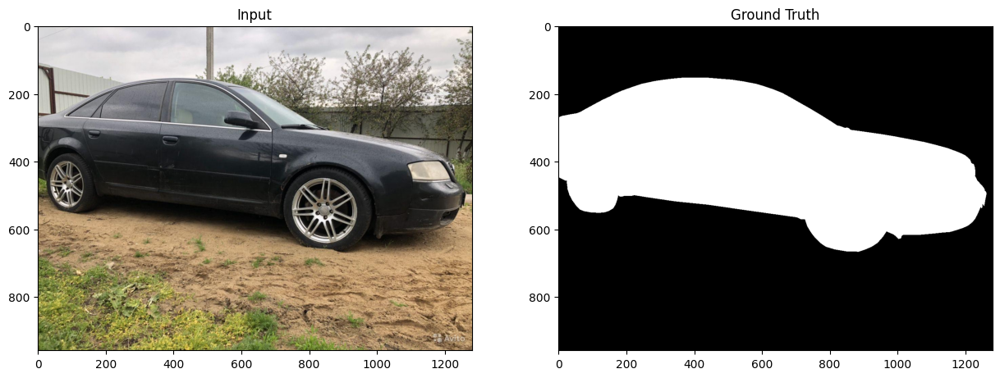

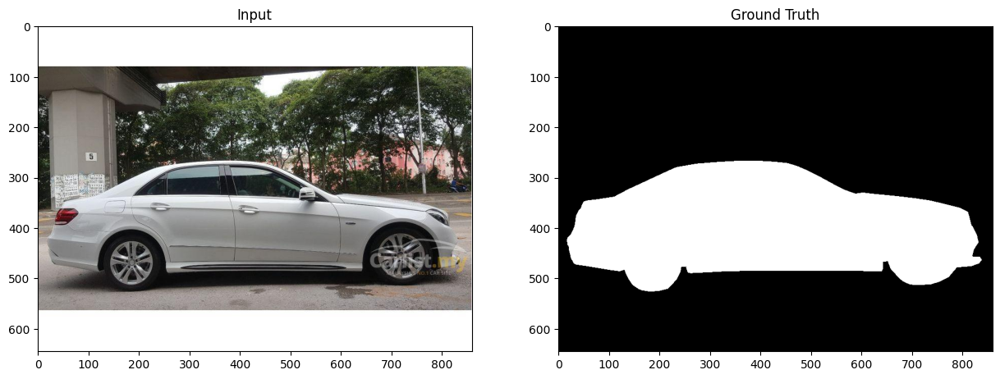

In [ ]:
import matplotlib.pyplot as plt
import os
import random
input_folder = '/content/U-2-Net/dataset/Image'
gt_folder = '/content/U-2-Net/dataset/Mask'

random_selection = random.sample(os.listdir(input_folder), 5)

for filename in random_selection:
    name, ext = os.path.splitext(filename)

    input_path = os.path.join(input_folder, filename)
    gt_path = os.path.join(gt_folder, name + '.png')

    input_img = plt.imread(input_path)
    gt_img = plt.imread(gt_path)

    fig, axs = plt.subplots(1, 2, figsize=(15, 10))
    axs[0].imshow(input_img)
    axs[0].set_title('Input')
    axs[1].imshow(gt_img, cmap='gray')
    axs[1].set_title('Ground Truth')

    plt.show()

# Dataset Creation

In this section, we will prepare the dataset for training our U2Net model. The dataset should be split into a training set and a validation set, and we will organize the data into folders as follows:

### Folder Structure

Our dataset folder structure will be organized as follows:

- **Dataset** as `dataset/`
  - **Train Data** as `train/`:
    - `Image/`: This folder contains training images.
    - `Mask/`: This folder contains corresponding masks for training images. Masks indicate the ground truth segmentation for each image in the training set.

  - **Validation Data** as `val/`:
    - `Image/`: This folder contains validation images.
    - `Mask/`: This folder contains corresponding masks for validation images.

Ensure that the filenames of the masks match those of the training and validation images, so the model can associate each image with its corresponding mask during training.

### Data Splitting

We've already split our dataset into two subsets:

- **Training Set**: This subset contains images in the `Image/` folder and their corresponding masks in the `Mask/` folder. It will be used to train our U2Net model.

- **Validation Set**: This subset contains images in the `Image/` folder and their corresponding masks in the `Mask/` folder. It will be used to validate the performance of our model during training and ensure it generalizes well to unseen data.

This organized folder structure will help streamline the training process. Now that our dataset is set up, we can proceed to the next section: training the U2Net model. Let's continue!


In [ ]:
import random
import os

input_dir = '/content/U-2-Net/dataset/Image'
mask_dir = '/content/U-2-Net/dataset/Mask'

input_imgs = [os.path.join(input_dir, f) for f in os.listdir(input_dir) if f.endswith('.jpg')]
masks = [os.path.join(mask_dir, f) for f in os.listdir(mask_dir) if f.endswith('.png')]

image_mask_pairs = []
for img_path in input_imgs:
   name = os.path.basename(img_path)[:-4]
   mask_path = os.path.join(mask_dir, name + '.png')
   if mask_path in masks:
     image_mask_pairs.append((img_path, mask_path))


# # Shuffle and split pairs
random.shuffle(image_mask_pairs)


In [ ]:
# %cd /content/U-2-Net
# !mkdir dataset
# %cd dataset

In [ ]:
%cd dataset
import os
import shutil

# Create folders
os.mkdir('train')
os.mkdir('val')
os.mkdir('train/Image')
os.mkdir('train/Mask')
os.mkdir('val/Image')
os.mkdir('val/Mask')

# List of image/mask pairs
img_pairs = image_mask_pairs

# Copy first 15 pairs to train folder
for img_pair in img_pairs[:15]:
    img_path, mask_path = img_pair
    shutil.copy(img_path, 'train/Image/')
    shutil.copy(mask_path, 'train/Mask/')

# Copy last 5 pairs to val folder
for img_pair in img_pairs[-5:]:
    img_path, mask_path = img_pair
    shutil.copy(img_path, 'val/Image/')
    shutil.copy(mask_path, 'val/Mask/')

%cd /content/U-2-Net

/content/U-2-Net/dataset
/content/U-2-Net


In [ ]:
%cd /content/U-2-Net

/content/U-2-Net


# Training U2NET

In this section, we'll discuss the custom training script `u2net_train_with_bce_loss.py` that you've created for training the U2Net model. This script was developed with reference to the [U-2-Net repository](https://github.com/xuebinqin/U-2-Net) and tailored to suit our specific application.

### Key Modifications

Here are the primary modifications made to the original script to adapt it for our task:

1. **Evaluation Metrics**: We have incorporated evaluation metrics such as Dice Score and Intersection over Union (IoU) matrices. These metrics help us assess the performance of the U2Net model accurately.

2. **Input Size**: The model input size has been set to 320x320 pixels. Adjusting the input size can impact the model's performance and resource requirements, and this size was chosen to suit our application.

3. **Loss Function**: We have implemented a basic multi-class Binary Cross-Entropy (BCE) loss function. The choice of loss function is critical for training a segmentation model, and the BCE loss is commonly used for binary segmentation tasks.

### How to Use

To train the U2Net model for our specific application, you can run the `u2net_train_with_bce_loss.py` script, making sure to specify the necessary parameters and file paths, such as dataset directories, training hyperparameters, and model configurations.

You can also refer to the original [U-2-Net repository](https://github.com/xuebinqin/U-2-Net) for additional details on the U2Net architecture and its usage.

Feel free to explore and modify the script further to fine-tune the training process for our specific requirements.

With this script, we are ready to train the U2Net model on our custom dataset and perform car segmentation. Let's proceed with the training process in the next section.


In [ ]:
%cd /content/U-2-Net
!python /content/U-2-Net/u2net_train_with_bce_loss.py

/content/U-2-Net
wandb: Currently logged in as: panulendave17. Use `wandb login --relogin` to force relogin
wandb: Tracking run with wandb version 0.15.10
wandb: Run data is saved locally in /content/U-2-Net/wandb/run-20230912_180129-r7xjjm7k
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run logical-smoke-26
wandb: ⭐️ View project at https://wandb.ai/panulendave17/inspeklab
wandb: 🚀 View run at https://wandb.ai/panulendave17/inspeklab/runs/r7xjjm7k
/usr/local/lib/python3.10/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))
---
train images:  15
train labels:  15
---
---
valin images:  5
valin labels:  5
---
---define optimizer...
---start training...
/usr/local/lib/python3.10/dist-packages/torch/nn/functional.py:3737: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsampl

## Tracking Metrics with Weights and Biases (wandb)

We have integrated Weights and Biases (wandb) for real-time metric tracking during model retraining. The following metrics are recorded:

- **Dice Score**: Measures segmentation accuracy.
- **IoU**: Assesses segmentation quality.
- **Training Loss**: Monitors optimization progress.
- **Validation Dice Score**: Evaluates generalization.
- **Validation IoU**: Validates performance on unseen data.
- **Validation Loss**: Detects overfitting.

This real-time monitoring aids in decision-making and hyperparameter tuning. In the following sections, we'll analyze these recorded metrics to assess the U2Net model's performance.


In [ ]:
import wandb
api = wandb.Api()

#find the experiment name above for charts
exp_name = "panulendave17/inspeklab/r7xjjm7k"

run = api.run(exp_name)
run.display(height=1080)

/usr/local/lib/python3.10/dist-packages/IPython/core/display.py:724: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


True

## Retraining the Model with Dice Loss

In this section, we will retrain the U2Net model using the `u2net_train_with_dice_loss.py` script. The retraining process will incorporate the following changes:

1. **Loss Function**: We will use the Dice Loss as the loss function for training the model. The Dice Loss is particularly suitable for segmentation tasks and can help improve the model's performance.

2. **Evaluation Metrics**: During retraining, we will include evaluation metrics such as Dice Score and Intersection over Union (IoU). These metrics provide a comprehensive assessment of the model's segmentation accuracy.

3. **Input Size**: The model's input size will remain at 320x320 pixels, as specified. This size has been chosen to match our application requirements.

### How to Use

To retrain the U2Net model with the Dice Loss and updated evaluation metrics, you can execute the `u2net_train_with_dice_loss.py` script, ensuring that you specify the necessary parameters and file paths. Make sure to use the same training and validation datasets that were used in the previous training step.

By incorporating the Dice Loss and evaluating the model's performance with Dice Score and IoU metrics, we aim to enhance the segmentation quality of the U2Net model for our specific application.

Let's proceed with the retraining process and evaluate the results in the following sections.


In [ ]:
%cd /content/U-2-Net
!python /content/U-2-Net/u2net_train_with_dice_loss.py

/content/U-2-Net
wandb: Currently logged in as: panulendave17. Use `wandb login --relogin` to force relogin
wandb: Tracking run with wandb version 0.15.10
wandb: Run data is saved locally in /content/U-2-Net/wandb/run-20230912_181727-ebqix8b4
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run soft-fire-27
wandb: ⭐️ View project at https://wandb.ai/panulendave17/inspeklab
wandb: 🚀 View run at https://wandb.ai/panulendave17/inspeklab/runs/ebqix8b4
---
train images:  15
train labels:  15
---
---
valin images:  5
valin labels:  5
---
---define optimizer...
---start training...
/usr/local/lib/python3.10/dist-packages/torch/nn/functional.py:3737: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
[epoch:   1/200, batch:    12/   15, ite: 1] train loss: 4.520683, tar: 0.594621, Dice Score: 0.490107, IoU: 0.324598
/usr/local/lib/python3.10/dist-

In [ ]:
exp_name = "panulendave17/inspeklab/ebqix8b4"

run = api.run(exp_name)
run.display(height=1080)

True

In [ ]:
import shutil

# Specify the folder you want to zip
folder_to_zip = "/content/U-2-Net/saved_models"

# Specify the name for the zip file
zip_filename = 'saved_models'

# Create a zip file
shutil.make_archive(zip_filename, 'zip', folder_to_zip)

# Move the zip file to /content to make it easily downloadable
shutil.move(zip_filename + '.zip', '/content')

# Provide a download link for the zip file
# from google.colab import files
# files.download('/content/saved_models.zip')


'/content/saved_models.zip'

In [ ]:
!mv /content/saved_models.zip /content/drive/MyDrive/colab_data

## Model Inferencing

In this section, we will employ our trained U2Net model for segmentation. We have trained two models, so it's important to specify the correct model name when running the `u2net_test.py` script.

The output segmentation mask will be saved in the `runs/model_name` folder, where `model_name` should be replaced with the specific name of the model you want to use.

Let's proceed with running the inference and generating segmentation masks for our images using the trained models.


In [ ]:
!python /content/U-2-Net/u2net_test.py --model_name u2net_muti_bce_loss_checkpoint_epoch_200 --image_dir /content/U-2-Net/dataset/Image

['/content/U-2-Net/dataset/Image/11.jpg', '/content/U-2-Net/dataset/Image/35.jpg', '/content/U-2-Net/dataset/Image/17.jpg', '/content/U-2-Net/dataset/Image/45.jpg', '/content/U-2-Net/dataset/Image/4.jpg', '/content/U-2-Net/dataset/Image/39.jpg', '/content/U-2-Net/dataset/Image/46.jpg', '/content/U-2-Net/dataset/Image/2.jpg', '/content/U-2-Net/dataset/Image/1.jpg', '/content/U-2-Net/dataset/Image/10.jpg', '/content/U-2-Net/dataset/Image/9.jpg', '/content/U-2-Net/dataset/Image/7.jpg', '/content/U-2-Net/dataset/Image/41.jpg', '/content/U-2-Net/dataset/Image/21.jpg', '/content/U-2-Net/dataset/Image/12.jpg', '/content/U-2-Net/dataset/Image/20.jpg', '/content/U-2-Net/dataset/Image/14.jpg', '/content/U-2-Net/dataset/Image/49.jpg', '/content/U-2-Net/dataset/Image/18.jpg', '/content/U-2-Net/dataset/Image/34.jpg']
inferencing: 11.jpg
/usr/local/lib/python3.10/dist-packages/torch/nn/functional.py:3737: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  war

## Task 3: Car Orientation Detection

In Task 3, we've developed a versatile logic for distinguishing between horizontal and vertical cars, regardless of image resolution or aspect ratio. This method analyzes the segmentation mask to categorize cars by their orientation.

This approach allows us to effectively differentiate between horizontally and vertically oriented cars, enabling subsequent analysis or post-processing based on this classification.


In [ ]:
def detect_car_orientation(masked_image):
    # Convert the masked image to grayscale
    gray = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)

    # Find contours in the grayscale image
    contours, _ = cv2.findContours(gray, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if len(contours) == 0:
        return "Orientation undetermined", None  # No car detected in the image

    # Assuming that the largest contour corresponds to the car
    largest_contour = max(contours, key=cv2.contourArea)

    # Fit an oriented bounding box to the largest contour
    rect = cv2.minAreaRect(largest_contour)
    box = cv2.boxPoints(rect)
    box = np.int0(box)

    x = box[:,0]
    y = box[:,1]

    width = np.max(x) - np.min(x)
    height = np.max(y) - np.min(y)

    if width > height:
      orientation = "Horizontal"
    else:
      orientation = "Vertical"

    return orientation

## Displaying Results with Four Columns

In this code section, we display results in a tabular format with four columns:

1. **Images**: This column displays the input images.

2. **Ground Truth Mask**: Here, you can see the ground truth segmentation mask for the cars.

3. **Predicted Mask**: This column showcases the segmentation masks predicted by our U2Net model.

4. **Predicted Orientation**: In this column, you can observe the predicted orientation of the cars, distinguishing between horizontal and vertical orientations.

This tabular presentation allows for a clear visual assessment of the model's performance in segmenting cars and identifying their orientations.


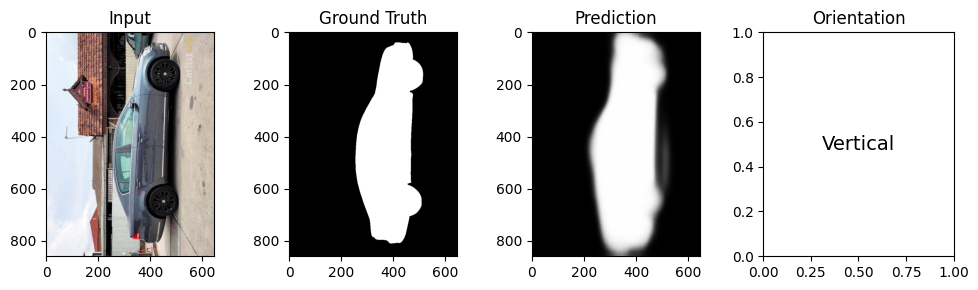

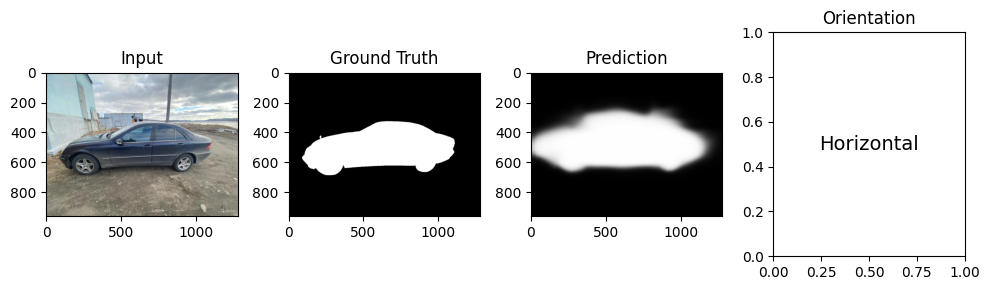

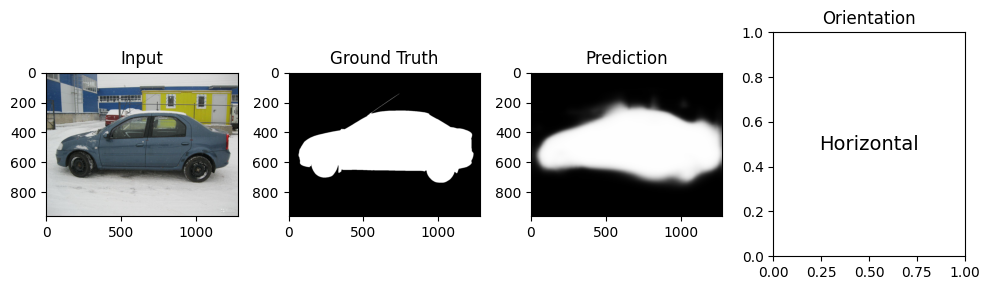

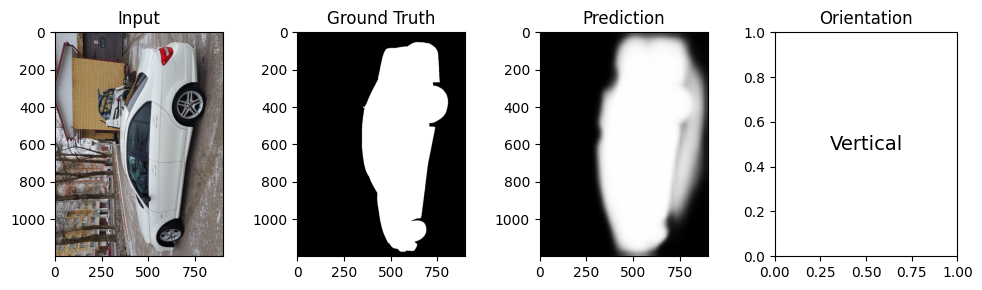

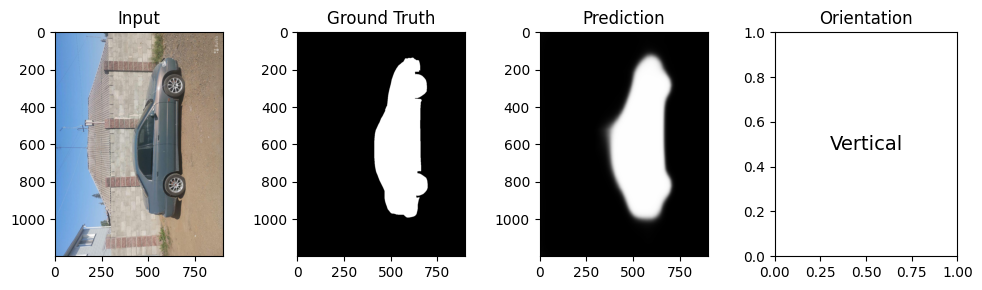

...

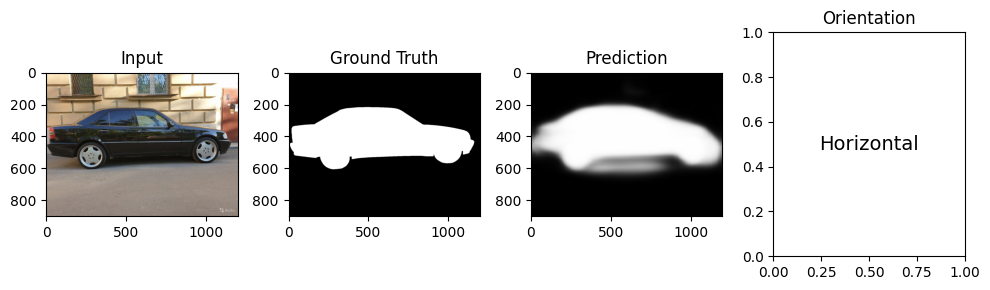

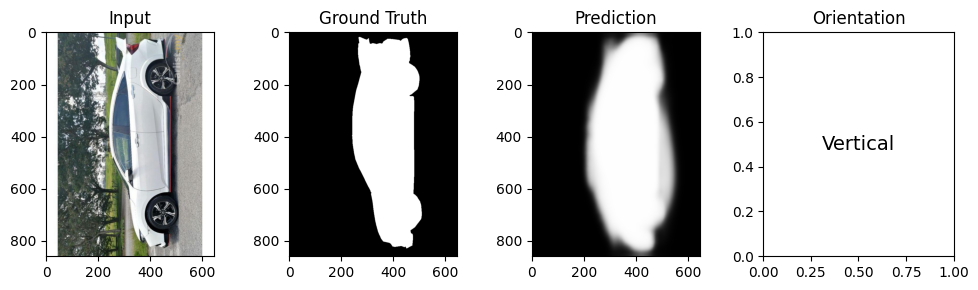

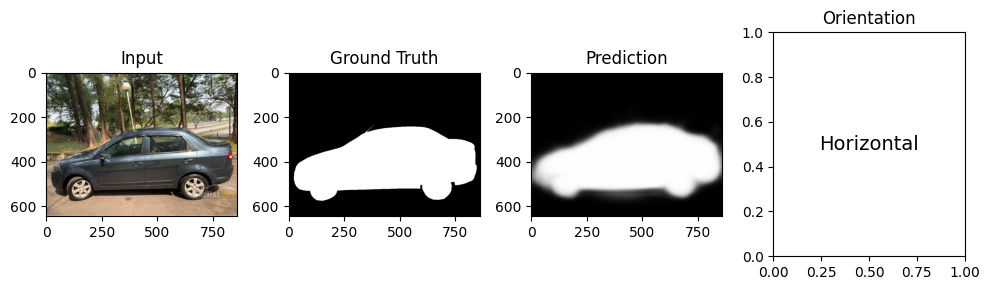

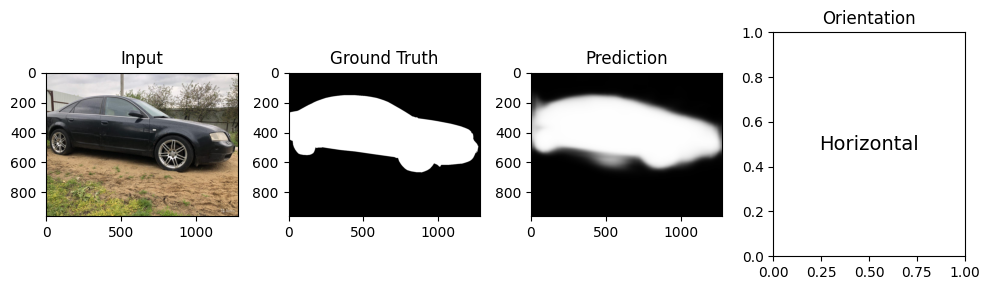

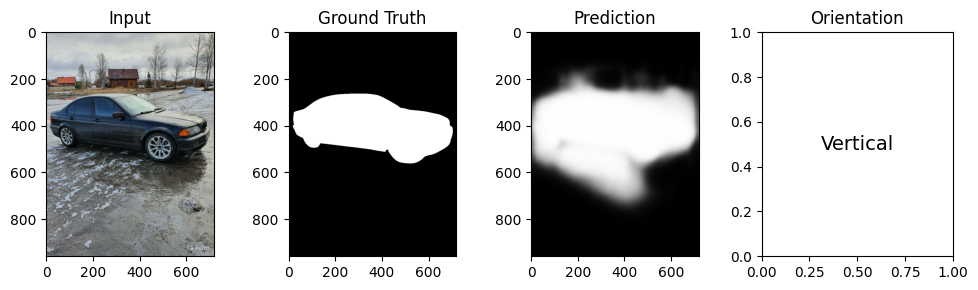

In [ ]:
import matplotlib.pyplot as plt
import os
import cv2
import numpy as np

input_folder = '/content/U-2-Net/dataset/Image'
gt_folder = '/content/U-2-Net/dataset/Mask'
mask_folder = '/content/U-2-Net/runs/u2net_muti_bce_loss_checkpoint_epoch_200_results'

for filename in os.listdir(input_folder):
    name, ext = os.path.splitext(filename)

    input_path = os.path.join(input_folder, filename)
    gt_path = os.path.join(gt_folder, name + '.png')
    mask_path = os.path.join(mask_folder, name + '.png')

    input_img = plt.imread(input_path)
    gt_img = plt.imread(gt_path)
    mask_img = cv2.imread(mask_path)
    orientation = detect_car_orientation(mask_img)


    fig, axs = plt.subplots(1, 4, figsize=(10, 3))
    axs[0].imshow(input_img)
    axs[0].set_title('Input')
    axs[1].imshow(gt_img, cmap='gray')
    axs[1].set_title('Ground Truth')
    axs[2].imshow(mask_img)
    axs[2].set_title('Prediction')
    # axs[3].axis('off')
    axs[3].text(0.5, 0.5, orientation,
          horizontalalignment='center',
          verticalalignment='center',
          fontsize=14)
    axs[3].set_title('Orientation')
    plt.tight_layout()

    plt.show()

## Inferencing on Second Model (Dice Loss)

In this section, we will perform inference using the second model, which was trained using the Dice loss function. This model is expected to have different performance characteristics compared to the first model, and we will assess its segmentation results and orientation predictions.

Let's proceed with running inference on the second model trained with Dice loss.


In [ ]:
!python /content/U-2-Net/u2net_test.py --model_name u2net_muti_dice_loss_checkpoint_epoch_200 --image_dir /content/U-2-Net/dataset/Image

['/content/U-2-Net/dataset/Image/11.jpg', '/content/U-2-Net/dataset/Image/35.jpg', '/content/U-2-Net/dataset/Image/17.jpg', '/content/U-2-Net/dataset/Image/45.jpg', '/content/U-2-Net/dataset/Image/4.jpg', '/content/U-2-Net/dataset/Image/39.jpg', '/content/U-2-Net/dataset/Image/46.jpg', '/content/U-2-Net/dataset/Image/2.jpg', '/content/U-2-Net/dataset/Image/1.jpg', '/content/U-2-Net/dataset/Image/10.jpg', '/content/U-2-Net/dataset/Image/9.jpg', '/content/U-2-Net/dataset/Image/7.jpg', '/content/U-2-Net/dataset/Image/41.jpg', '/content/U-2-Net/dataset/Image/21.jpg', '/content/U-2-Net/dataset/Image/12.jpg', '/content/U-2-Net/dataset/Image/20.jpg', '/content/U-2-Net/dataset/Image/14.jpg', '/content/U-2-Net/dataset/Image/49.jpg', '/content/U-2-Net/dataset/Image/18.jpg', '/content/U-2-Net/dataset/Image/34.jpg']
inferencing: 11.jpg
/usr/local/lib/python3.10/dist-packages/torch/nn/functional.py:3737: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  war

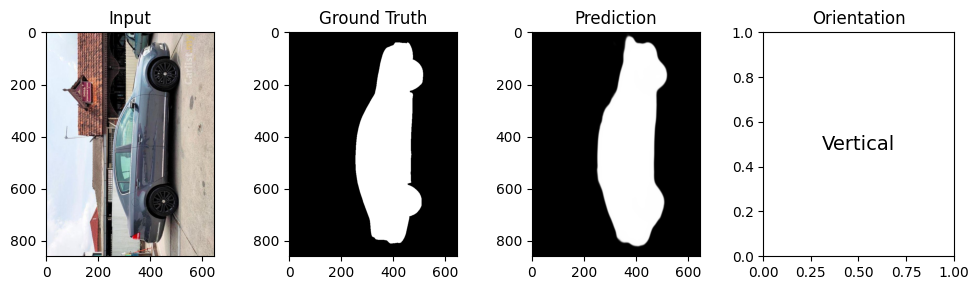

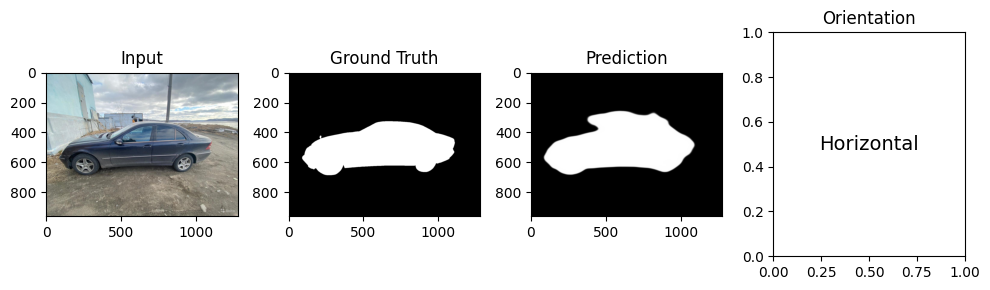

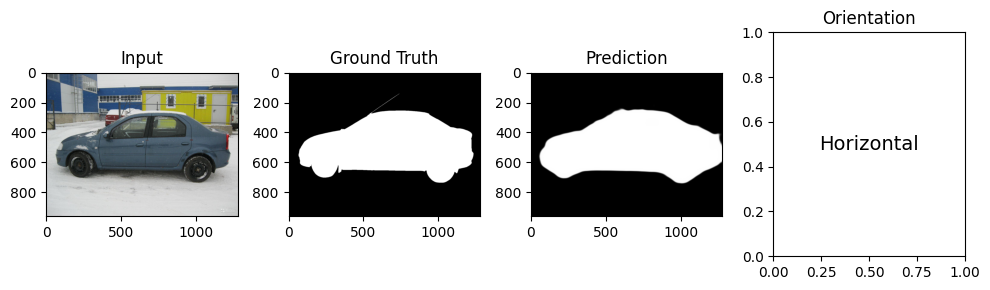

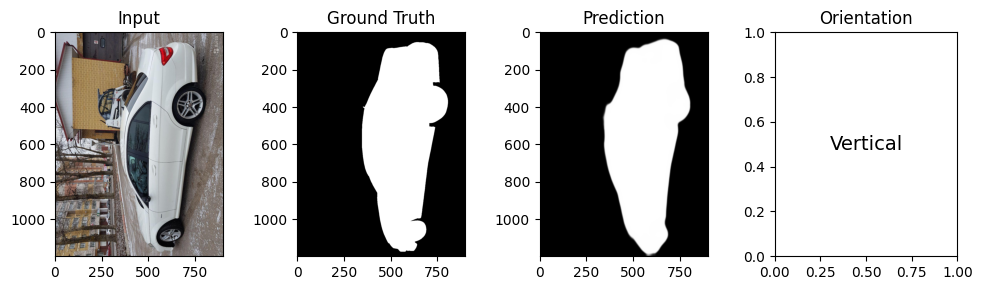

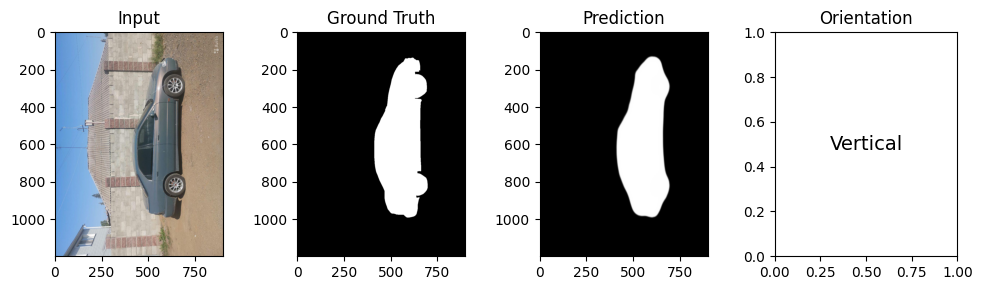

...

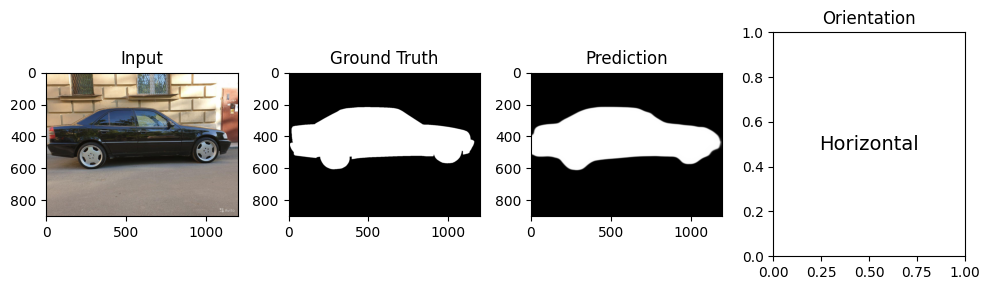

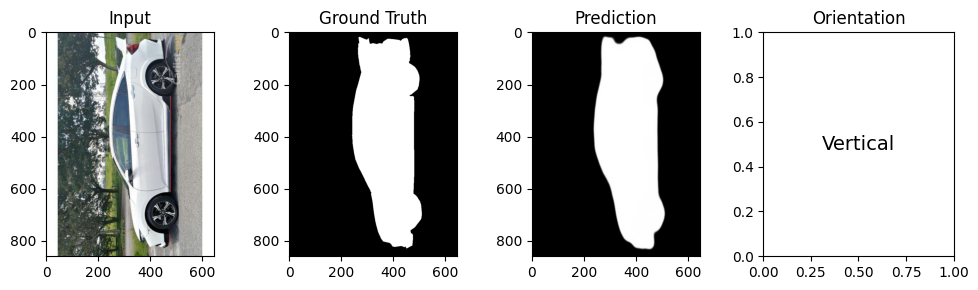

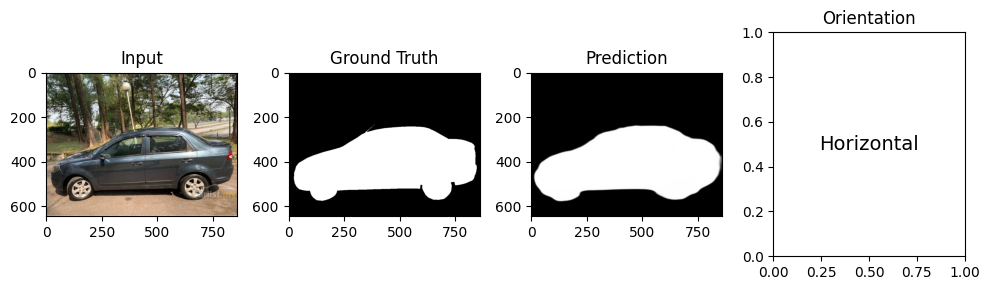

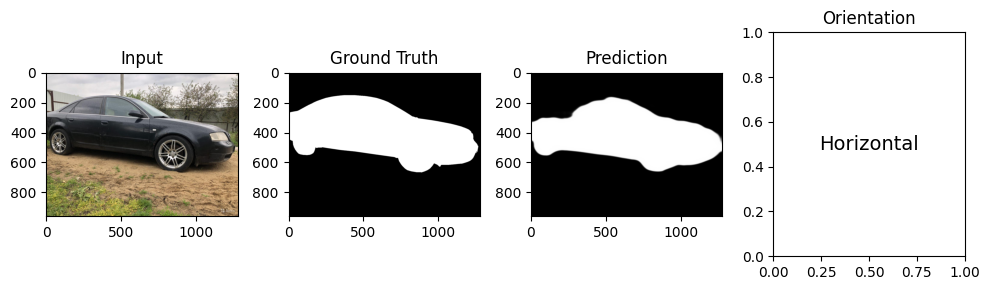

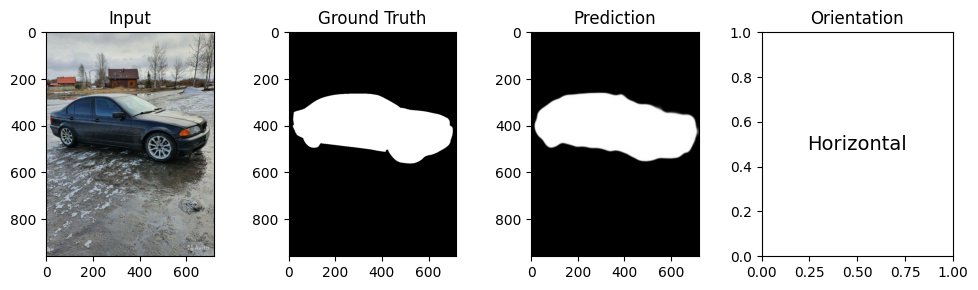

In [ ]:
import matplotlib.pyplot as plt
import os
import cv2
import numpy as np

input_folder = '/content/U-2-Net/dataset/Image'
gt_folder = '/content/U-2-Net/dataset/Mask'
mask_folder = '/content/U-2-Net/runs/u2net_muti_dice_loss_checkpoint_epoch_200_results'

for filename in os.listdir(input_folder):
    name, ext = os.path.splitext(filename)

    input_path = os.path.join(input_folder, filename)
    gt_path = os.path.join(gt_folder, name + '.png')
    mask_path = os.path.join(mask_folder, name + '.png')

    input_img = plt.imread(input_path)
    gt_img = plt.imread(gt_path)
    mask_img = cv2.imread(mask_path)
    orientation = detect_car_orientation(mask_img)


    fig, axs = plt.subplots(1, 4, figsize=(10, 3))
    axs[0].imshow(input_img)
    axs[0].set_title('Input')
    axs[1].imshow(gt_img, cmap='gray')
    axs[1].set_title('Ground Truth')
    axs[2].imshow(mask_img)
    axs[2].set_title('Prediction')
    # axs[3].axis('off')
    axs[3].text(0.5, 0.5, orientation,
          horizontalalignment='center',
          verticalalignment='center',
          fontsize=14)
    axs[3].set_title('Orientation')
    plt.tight_layout()

    plt.show()

# Adding background
## Task 4: Adding Virtual Background and Shadows

- **Script**: Developed a Python script called `car_virtual_background.py`.
- **Input Parameters**:
  - `--image_dir`: Path to the image directory.
  - `--mask_dir`: Path to the mask directory.
  - `--background_path`: Path to the virtual background image. you can choose any background picture.
  - `--save_dir`: Path to the directory where results will be saved.

The script processes images, applies virtual backgrounds, and handles shadows. It then saves the enhanced images in the specified `save_dir` folder. This step adds realism to segmented cars, placing them in a different environment with shadows taken into account.




In [ ]:
!python car_virtual_background.py \
  --image_dir /content/U-2-Net/dataset/Image  \
  --mask_dir /content/U-2-Net/runs/u2net_muti_dice_loss_checkpoint_epoch_200_results  \
  --background_path /content/U-2-Net/saved_models/background.jpg \
  --save_dir /content/U-2-Net/car_virtual_bg/u2net_dice_200

Folder '/content/U-2-Net/car_virtual_bg/u2net_dice_200' created successfully.


In [ ]:
!python car_virtual_background.py \
  --image_dir /content/U-2-Net/dataset/Image  \
  --mask_dir /content/U-2-Net/dataset/Mask  \
  --background_path /content/U-2-Net/saved_models/background.jpg \
  --save_dir /content/U-2-Net/car_virtual_bg/ground_truth

Folder '/content/U-2-Net/car_virtual_bg/ground_truth' created successfully.


## Displaying Results with Three Columns

In this code section, we present our results in a tabular format with three columns:

1. **Input Image**: This column displays the original input images.

2. **Virtual Background with Ground Truth Mask**: Here, you can see the virtual background applied to the input image using the ground truth mask. This provides a visualization of the segmentation results with the actual mask.

3. **Virtual Background with Predicted Mask**: This column showcases the virtual background applied to the input image using the predicted mask generated by our custom-trained model. This demonstrates the model's segmentation performance in a real-world context.

These visualizations allow us to compare the segmentation accuracy of the model against the ground truth and assess the effectiveness of adding virtual backgrounds.


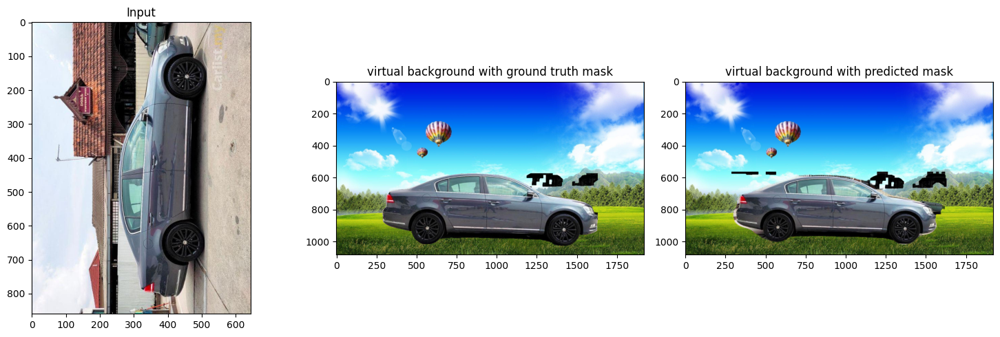

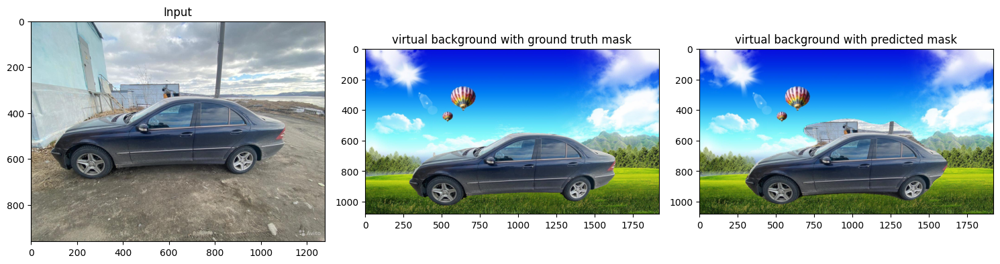

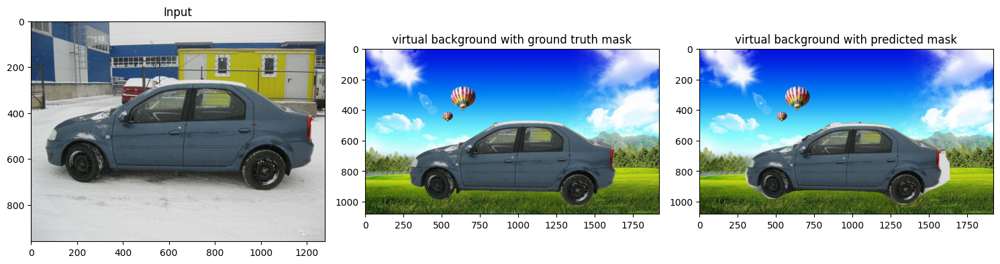

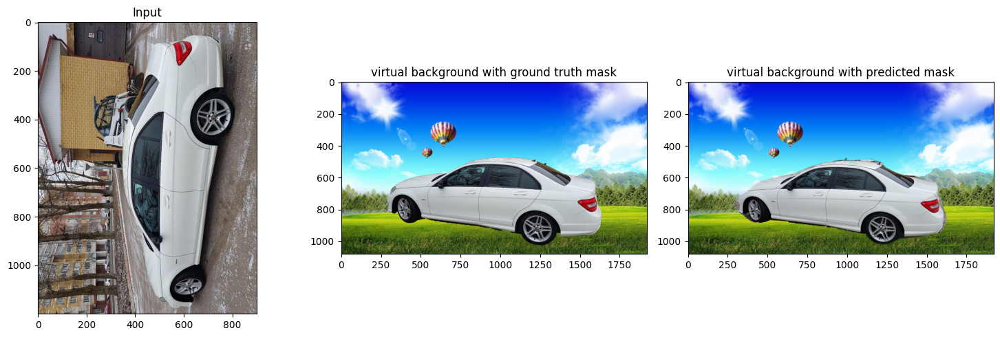

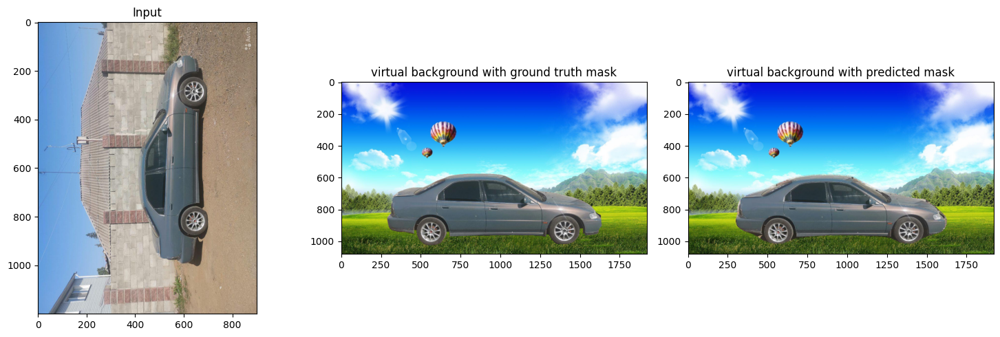

...

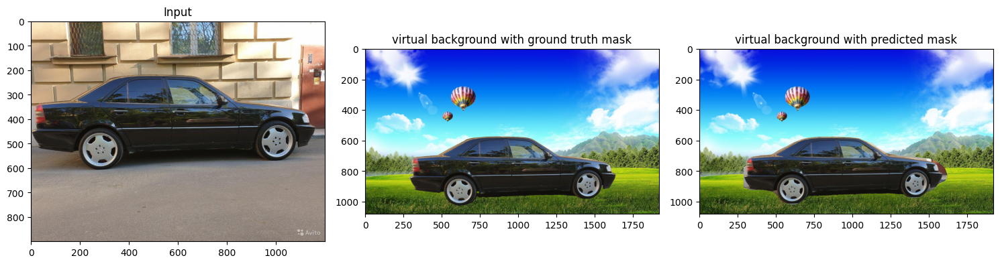

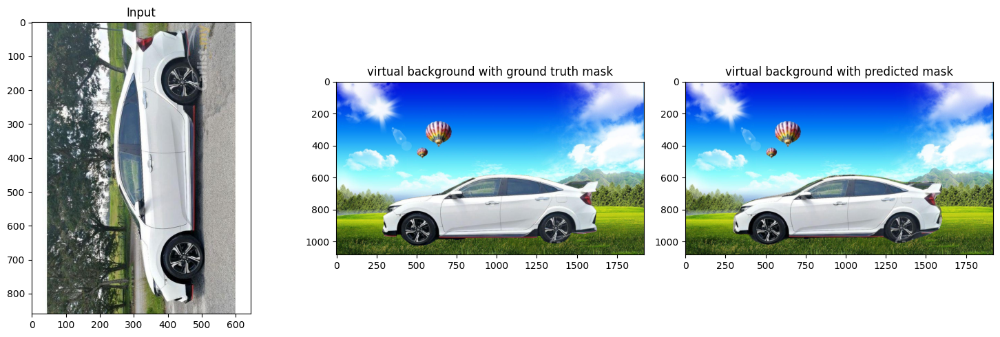

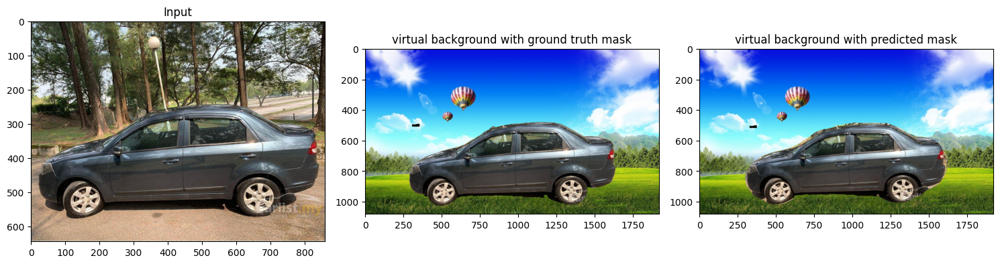

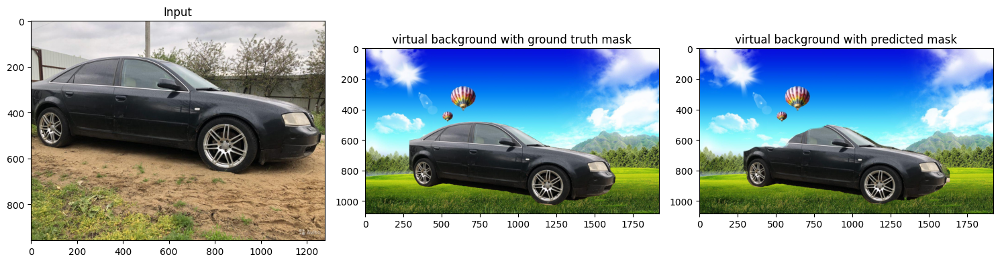

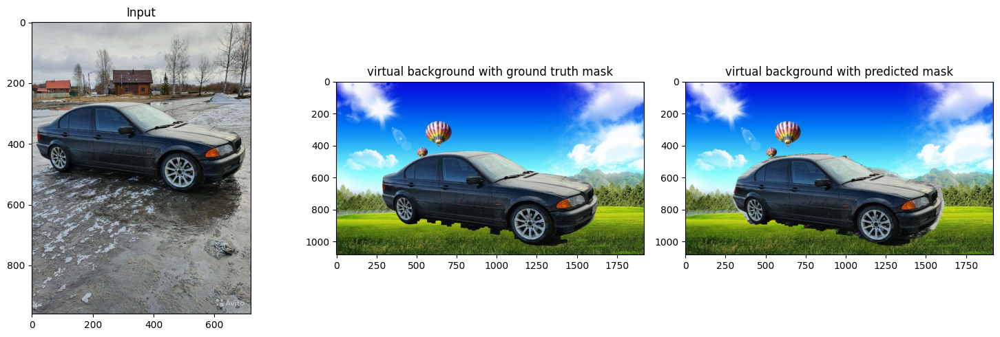

In [ ]:
import matplotlib.pyplot as plt
import os
import cv2
import numpy as np

input_folder = '/content/U-2-Net/dataset/Image'
gt_folder = '/content/U-2-Net/car_virtual_bg/ground_truth'
new_trained = '/content/U-2-Net/car_virtual_bg/u2net_dice_200'

for filename in os.listdir(input_folder):
    name, ext = os.path.splitext(filename)

    input_path = os.path.join(input_folder, filename)
    gt_path = os.path.join(gt_folder, name + '.png')
    mask_path = os.path.join(new_trained, name + '.png')

    input_img = plt.imread(input_path)
    gt_img = plt.imread(gt_path)
    mask_img = cv2.imread(mask_path)
    mask_img = cv2.cvtColor(mask_img, cv2.COLOR_BGR2RGB)
    orientation = detect_car_orientation(mask_img)


    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    axs[0].imshow(input_img)
    axs[0].set_title('Input')
    axs[1].imshow(gt_img, cmap='gray')
    axs[1].set_title('virtual background with ground truth mask')
    axs[2].imshow(mask_img)
    axs[2].set_title('virtual background with predicted mask')
    plt.tight_layout()

    plt.show()